# Análisis DOAJ automatizado en R dentro de un entorno Jupyter Notebook
### Diseñado y mantenido por Romina De León ([HDLAB CONICET](https://hdlab.space/))
#### [rdeleon@conicet.gov.ar](rdeleon@conicet.gov.ar)

## Objetivo
Esta notebook realiza análisis en tiempo real de la base de datos de las publicaciones de DOAJ.

## Librerías a utilizar
Cada una de estas librerías se utilizan para realizar análisis estadístico y visualizaciones de la base de datos generada por [DOAJ](https://doaj.org/) en formato CSV.

In [70]:
# Lista de librerías necesarias, se instalan y cargan
librerias <- c(
  "tidyverse", "RColorBrewer", "paletteer", "datos", "gapminder", "tradestatistics", "highcharter",
  "treemapify", "ggplot2", "rio", "echarts4r", "plotly", "tidytext", "dplyr", "tidyselect",
  "purrr", "readr", "stringr", "webshot", "htmlwidgets", "pandoc", "forcats",
"cowplot", "ggrepel", "sf", "rnaturalearth", "countrycode", "scico", "Cairo",
"colorspace", "Polychrome", "MetBrewer", "ggsci", "zoo"
)
# Instalación
librerias_faltantes <- librerias[!librerias %in% installed.packages()[, "Package"]]
if(length(librerias_faltantes) > 0){
  message("Instalando librerias faltantes: ", paste(librerias_faltantes, collapse = ", "))
  install.packages(librerias_faltantes, dependencies = TRUE, INSTALL_opts = '--no-lock')
}

# Función para cargar un librerias y notificar errores
cargar_paquete <- function(pkg){
  tryCatch({
    library(pkg, character.only = TRUE)
    message("Cargado correctamente: ", pkg)
  }, error = function(e){
    warning("No se pudo cargar: ", pkg, "\n", e)
  })
}

# Cargar todos los librerias
invisible(lapply(librerias, cargar_paquete))


Cargado correctamente: tidyverse

Cargado correctamente: RColorBrewer

Cargado correctamente: paletteer

Cargado correctamente: datos

Cargado correctamente: gapminder

Cargado correctamente: tradestatistics

Cargado correctamente: highcharter

Cargado correctamente: treemapify

Cargado correctamente: ggplot2

Cargado correctamente: rio

Cargado correctamente: echarts4r

Cargado correctamente: plotly

Cargado correctamente: tidytext

Cargado correctamente: dplyr

Cargado correctamente: tidyselect

Cargado correctamente: purrr

Cargado correctamente: readr

Cargado correctamente: stringr

Cargado correctamente: webshot

Cargado correctamente: htmlwidgets

Cargado correctamente: pandoc

Cargado correctamente: forcats

Cargado correctamente: cowplot

Cargado correctamente: ggrepel

Cargado correctamente: sf

Cargado correctamente: rnaturalearth

Cargado correctamente: countrycode

Cargado correctamente: scico

Cargado correctamente: Cairo

Cargado correctamente: colorspace

Cargado correc

In [2]:
# URL oficial de DOAJ
url_doaj <- "https://doaj.org/csv"
# Descargar del CSV
temp <- tempfile(fileext = ".csv")
download.file(url_doaj, destfile = temp, method = "libcurl")

# Lectura de la BBDD
journal_csv <- read.csv(temp, stringsAsFactors = FALSE)

# transformación en tibble
journal <- as_tibble(journal)
head(journal)

Journal.title,Journal.URL,URL.in.DOAJ,When.did.the.journal.start.to.publish.all.content.using.an.open.license.,Alternative.title,Journal.ISSN..print.version.,Journal.EISSN..online.version.,Keywords,Languages.in.which.the.journal.accepts.manuscripts,Publisher,⋯,Does.the.journal.comply.to.DOAJ.s.definition.of.open.access.,Continues,Continued.By,LCC.Codes,Subscribe.to.Open,Subjects,Added.on.Date,Last.updated.Date,Number.of.Article.Records,Most.Recent.Article.Added
<chr>,<chr>,<chr>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<chr>
Bollettino Studi Sartriani,https://www.grupporicercasartriana.org/chi-siamo/#,https://doaj.org/toc/9096cfa407424c07b1ff10dd9e9174c4,2018,,,1970-7983,"jean-paul sartre, philosophy, existentialism, moral philosophy, french philosophy, humanities","Italian, French, English",RomaTrE_Press,⋯,Yes,,,B1-5802,No,Philosophy. Psychology. Religion: Philosophy (General),2023-07-20T15:32:51Z,2023-07-20T15:32:51Z,0,
Науковий Вісник Південноукраїнського Національного Педагогічного Університету імені К. Д. Ушинського,https://nv.pdpu.edu.ua,https://doaj.org/toc/7aabd1069b1f4ff7aea1499fb1ed3e94,2011,Scientific Bulletin of South Ukrainian National Pedagogical University Named after K. D. Ushynsky,2414-5076,2617-6688,"pedagogical sciences, didactics, linguodidactics, education, upbringing, teaching methods","English, Ukrainian",State institution “South Ukrainian National Pedagogical University named after K D. Ushynsky”,⋯,Yes,,,L7-991,No,Education: Education (General),2019-06-10T12:20:13Z,2023-07-21T07:15:19Z,295,2024-02-09T20:33:16Z
Neurosurgery Open,https://journals.lww.com/neuopenonline/pages/default.aspx,https://doaj.org/toc/146b2b7b0d984464b7ac4e6988b0a6f6,2020,,,2633-0873,"neurosurgery, surgery, neurosciences",English,Wolters Kluwer,⋯,Yes,,2834-4383,RD1-811|RC321-571,No,Medicine: Surgery | Medicine: Internal medicine: Neurosciences. Biological psychiatry. Neuropsychiatry,2021-08-10T10:56:37Z,2023-07-20T16:10:49Z,0,
CES Transactions on Electrical Machines and Systems,http://www.cestems.org,https://doaj.org/toc/3373f1e5368942ca84760b878b4d6162,2017,,2096-3564,2837-0325,"machine, motor, driver, electrification of transportation, electronics",English,China Electrotechnical Society,⋯,Yes,,,TK1-9971,No,Technology: Electrical engineering. Electronics. Nuclear engineering,2023-07-21T07:32:16Z,2023-07-21T07:32:16Z,374,2025-04-02T03:38:30Z
Finzioni,https://finzioni.unibo.it,https://doaj.org/toc/3e78e2d80348469ea9eded60d68d0fa7,2021,Finzioni: Rivista di Teoria Critica e Letteratura Italiana Contemporanea,,2785-2288,"italian literature, literary criticism, text analysis, italian novel, italian poetry, literature and the arts","Italian, English",University of Bologna,⋯,Yes,,,PQ1-3999,No,Language and Literature: French literature - Italian literature - Spanish literature - Portuguese literature,2022-07-12T13:44:34Z,2023-07-21T07:41:54Z,105,2025-03-04T16:21:37Z
Ricerche di Pedagogia e Didattica,http://rpd.unibo.it/,https://doaj.org/toc/88d8279d9d2541dca4a67255d95f073e,2006,Journal of Theories and Research in Education,,1970-2221,"social science education, teaching education, education management, multiculturalism, educational and social services, philosophy of education","Italian, English",University of Bologna,⋯,Yes,,,L7-991,No,Education: Education (General),2008-07-11T14:33:02Z,2023-07-21T07:48:54Z,613,2025-01-14T16:22:29Z


### Selección de columnas de la BBDD

In [3]:
head(journal[, c("Journal.title", "Subjects", "Keywords")], 15)

Journal.title,Subjects,Keywords
<chr>,<chr>,<chr>
Bollettino Studi Sartriani,Philosophy. Psychology. Religion: Philosophy (General),"jean-paul sartre, philosophy, existentialism, moral philosophy, french philosophy, humanities"
Науковий Вісник Південноукраїнського Національного Педагогічного Університету імені К. Д. Ушинського,Education: Education (General),"pedagogical sciences, didactics, linguodidactics, education, upbringing, teaching methods"
Neurosurgery Open,Medicine: Surgery | Medicine: Internal medicine: Neurosciences. Biological psychiatry. Neuropsychiatry,"neurosurgery, surgery, neurosciences"
CES Transactions on Electrical Machines and Systems,Technology: Electrical engineering. Electronics. Nuclear engineering,"machine, motor, driver, electrification of transportation, electronics"
Finzioni,Language and Literature: French literature - Italian literature - Spanish literature - Portuguese literature,"italian literature, literary criticism, text analysis, italian novel, italian poetry, literature and the arts"
Ricerche di Pedagogia e Didattica,Education: Education (General),"social science education, teaching education, education management, multiculturalism, educational and social services, philosophy of education"
Didattica della storia,Education: Theory and practice of education | History (General) and history of Europe,"didactics of history, research and experiences in history teaching, local history, world history"
Operations Research and Decisions,"Social Sciences: Industries. Land use. Labor: Management. Industrial management | Social Sciences: Industries. Land use. Labor: Economic growth, development, planning","mathematical modelling, forecasting, econometrics and statistical methods, optimization, computer applications in optimization"
Journal of Management and Business Education,Education: Special aspects of education | Social Sciences: Commerce: Business,"teaching, learning, management, education, business"


In [4]:
print(paste("Total de publicaciones en la base de datos de DOAJ:", length(journal$Journal.title)))

[1] "Total de publicaciones en la base de datos de DOAJ: 21512"


## Manipulación y limpieza de la base de datos
Para poder renombras las columnas 

In [5]:
colnames(journal)

[1] "Journal.title"                                                              
 [2] "Journal.URL"                                                                
 [3] "URL.in.DOAJ"                                                                
 [4] "When.did.the.journal.start.to.publish.all.content.using.an.open.license."   
 [5] "Alternative.title"                                                          
 [6] "Journal.ISSN..print.version."                                               
 [7] "Journal.EISSN..online.version."                                             
 [8] "Keywords"                                                                   
 [9] "Languages.in.which.the.journal.accepts.manuscripts"                         
[10] "Publisher"                                                                  
[11] "Country.of.publisher"                                                       
[12] "Other.organisation"                                                         
[13] "Country.of.other.organisation"                                              
[14] "Journal.license"                                                            
[15] "License.attributes"                                                         
[16] "URL.for.license.terms"                                                      
[17] "Machine.readable.CC.licensing.information.embedded.or.displayed.in.articles"
[18] "Author.holds.copyright.without.restrictions"                                
[19] "Copyright.information.URL"                                                  
[20] "Review.process"                                                             
[21] "Review.process.information.URL"                                             
[22] "Journal.plagiarism.screening.policy"                                        
[23] "URL.for.journal.s.aims...scope"                                             
[24] "URL.for.the.Editorial.Board.page"                                           
[25] "URL.for.journal.s.instructions.for.authors"                                 
[26] "Average.number.of.weeks.between.article.submission.and.publication"         
[27] "APC"                                                                        
[28] "APC.information.URL"                                                        
[29] "APC.amount"                                                                 
[30] "Journal.waiver.policy..for.developing.country.authors.etc."                 
[31] "Waiver.policy.information.URL"                                              
[32] "Has.other.fees"                                                             
[33] "Other.fees.information.URL"                                                 
[34] "Preservation.Services"                                                      
[35] "Preservation.Service..national.library"                                     
[36] "Preservation.information.URL"                                               
[37] "Deposit.policy.directory"                                                   
[38] "URL.for.deposit.policy"                                                     
[39] "Persistent.article.identifiers"                                             
[40] "Does.the.journal.comply.to.DOAJ.s.definition.of.open.access."               
[41] "Continues"                                                                  
[42] "Continued.By"                                                               
[43] "LCC.Codes"                                                                  
[44] "Subscribe.to.Open"                                                          
[45] "Subjects"                                                                   
[46] "Added.on.Date"                                                              
[47] "Last.updated.Date"                                                          
[48] "Number.of.Article.Records"                                                  
[49] "Most.Recent

#### Creación nuevo tibble para manipular la información, según criterios de análisis

In [6]:
journal.select <- journal%>% select(Journal.title, Country.of.publisher, Languages.in.which.the.journal.accepts.manuscripts, Journal.license, Publisher, Review.process, Subjects, APC, Persistent.article.identifiers, Keywords, Added.on.Date)

#### Renombrar y simplificar nombre de columnas

In [7]:
journal.select <- journal.select %>%
  rename(title = Journal.title) %>%
  rename(country = Country.of.publisher) %>%
  rename(language = Languages.in.which.the.journal.accepts.manuscripts) %>%
  rename (license = Journal.license) %>%
  rename (Review = Review.process) %>%
  rename (Ids = Persistent.article.identifiers) %>%
  rename (Added = Added.on.Date)

#### Conversión de la columna Added.on.Date en formato año-mes-día

In [8]:
journal.select$Added <- as.Date(journal.select$Added) 

#### Limpieza de la columna "Subjects" 
Se realiza una limpieza y selección de las primeras dos palabras, dentro de los temas de las publicaciones para falicitar manipulación, análisis y visualizaciones

In [9]:
journal.select$Subjects <- str_extract(journal.select$Subjects, "\\w+(?:[^\\w]+\\w+){0,1}")

In [10]:
#eliminación signos de puntuación
journal.select$Subjects <- gsub("[[:punct:]]", "", journal.select$Subjects)

In [11]:
journal.select <- journal.select %>%
  mutate(Subjects = str_trim(Subjects)) %>%
  mutate(Subjects = sapply(Subjects, function(x) {
    words <- str_split(x, "\\s{2,}|,|\\s*\\band\\b\\s*|\\s+")[[1]]  # dividir por palabras, "and", comas, o espacios
    words <- unique(words[words != ""])  # eliminar vacíos y duplicados
    paste(words, collapse = " ")
  }))

#### Limpieza columna "Language"
Se realiza una función para que organice los idiomas, que permite  facilitar las visualizaciones y la manipulación del tibble.

In [12]:
# Crear una función para ordenar los idiomas en una lista
sort_languages <- function(language_list) {
  sorted_languages <- sort(unlist(strsplit(language_list, ", ")))
  return(paste(sorted_languages, collapse = ", "))
}

In [13]:
# Aplicar la función a cada celda en la columna 'language'
journal.select$language <- sapply(journal.select$language, sort_languages)

#### Limpieza de la columna de Identificadores persistentes

In [14]:
# Crear una función para ordenar los ids
sort_ids <- function(ids_list) {
  sorted_ids <- sort(unlist(strsplit(ids_list, ", ")))
  return(paste(sorted_ids, collapse = ", "))
}

In [15]:
# Aplicar la función a cada celda en la columna 'ids'
journal.select$Ids <- sapply(journal.select$Ids, sort_ids)

#### Funciones varias

In [16]:
# Función caption
#an_actual <- format(Sys.Date(), "%Y")
add_caption <- function(author = "Romina De León y Gimena del Rio", year = format(Sys.Date(), "%Y")) {
  paste0("Citar como: ", author, ", ", year, 
         ". Análisis de revistas latinoamericanas en DOAJ.")
}

#Función para guardar gráficos
save_graf <- function(plot, filename = NULL, type = "default", dpi = 300) {
  # Nombre de archivo, según el title del gráfico
  if (is.null(filename)) {
    if (!is.null(plot$labels$title)) {
      filename <- gsub("[^[:alnum:]_]+", "_", plot$labels$title)
    } else {
      filename <- paste0("grafico_", format(Sys.time(), "%Y%m%d_%H%M%S"))
    }
  }
  
  # Para ggplot
  if (inherits(plot, "ggplot")) {
    dims <- switch(
      type,
      "map" = list(width = 3000, height = 2000),
      "bar" = list(width = 2500, height = 2000),
      "line" = list(width = 3000, height = 1500),
      "scatter" = list(width = 2000, height = 2000),
      "heatmap" = list(width = 2500, height = 2500),
      "default" = list(width = 2000, height = 1500)
    )
    ggsave(paste0(filename, ".png"), plot = plot,
           width = dims$width, height = dims$height,
           units = "px", dpi = dpi)
  }
  
  # Para gráficos interactivos 
  else if (inherits(plot, "htmlwidget")) {
    htmlwidgets::saveWidget(plot, paste0(filename, ".html"), selfcontained = TRUE)
    # opcional: webshot2::webshot(paste0(filename, ".html"), file = paste0(filename, ".png"))
  }
  
  message("Gráfico guardado en: ", filename)
}

# para gráficos 
options(repr.plot.width = 12, repr.plot.height = 8)

### Publicaciones totales en DOAJ
Creación de un df con porcentajes y cantidades de publicaciones por países

In [17]:
porcen_journal <- journal.select %>%
  group_by(country)%>%
  count()%>%
  ungroup()%>%
  mutate(percentage= round(n / sum(n) * 100, 2)) %>%
  bind_rows(data.frame(country = "Total", n = NA, percentage = sum(.$percentage)))
porcen_journal[order(porcen_journal$n, decreasing = TRUE),] 

country,n,percentage
<chr>,<int>,<dbl>
Indonesia,2481,11.53
United Kingdom,2179,10.13
Brazil,1558,7.24
United States,1230,5.72
"Iran, Islamic Republic of",974,4.53
Spain,973,4.52
Poland,918,4.27
Switzerland,771,3.58
Russian Federation,610,2.84


## Visualizaciones
Este apartado estará dividido entre gráficas de publicaciones de todo el mundo y de América Latian

### Gráfico de georreferenciación de las publicaciones 


In [18]:
options(repr.plot.width = 12, repr.plot.height = 8)

Warning message in st_point_on_surface.sfc(sf::st_zm(x)):
"st_point_on_surface may not give correct results for longitude/latitude data"
Warning message in st_point_on_surface.sfc(sf::st_zm(x)):
"st_point_on_surface may not give correct results for longitude/latitude data"
Warning message in st_point_on_surface.sfc(sf::st_zm(x)):
"st_point_on_surface may not give correct results for longitude/latitude data"
Warning message in st_point_on_surface.sfc(sf::st_zm(x)):
"st_point_on_surface may not give correct results for longitude/latitude data"
Warning message in st_point_on_surface.sfc(sf::st_zm(x)):
"st_point_on_surface may not give correct results for longitude/latitude data"
Warning message in st_point_on_surface.sfc(sf::st_zm(x)):
"st_point_on_surface may not give correct results for longitude/latitude data"
Warning message in st_point_on_surface.sfc(sf::st_zm(x)):
"st_point_on_surface may not give correct results for longitude/latitude data"
Warning message in st_point_on_surface.sf

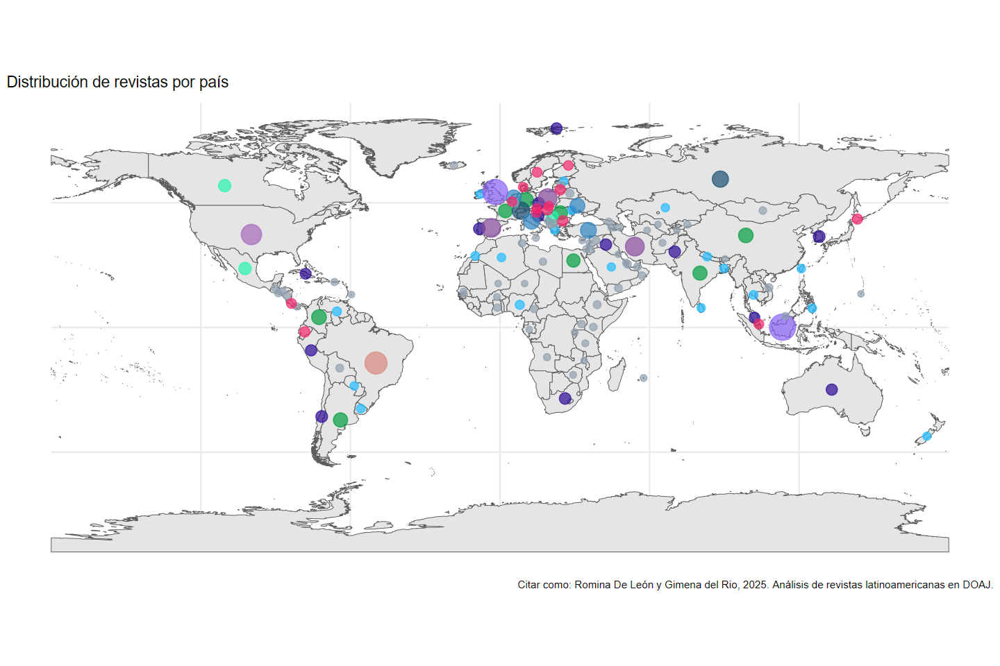

In [19]:
p1 <- suppressWarnings(
ne_countries(scale = "large", returnclass = "sf") %>% 
left_join(
    porcen_journal %>%
    filter(!country %in% c("Total")) %>%
      mutate(
             country = trimws(country),
             country_std = case_when(
                country %in% c("United States", "USA") ~ "United States of America",
                TRUE ~ countrycode(country, origin = "country.name", destination = "country.name")
                ),
             country_std = coalesce(country_std, country),
             color_point = case_when( n <= 20 ~ "#91A1AF",
                                      n <= 50 ~ "#21BCFF",
                                      n <= 100 ~ "#F5276C",
                                      n <= 200 ~ "#2C0995",
                                      n <= 300 ~ "#27F5B0",
                                      n <= 450 ~ "#009E3F",
                                      n <= 600 ~ "#2e86c1",
                                      n <= 800 ~ "#1b4f72",
                                      n <= 1000 ~ "#884ea0",
                                      n <= 1250 ~ "#a569bd",
                                      n <= 1500 ~ "#af7ac5",
                                      n <= 1750 ~ "#d98880",
                                      n <= 2500 ~ "#8965F6",
                                      n <= 3500 ~"729509",
                                      TRUE ~ "darkblue"
    )
      ),
    by = c("name" = "country_std")
  ) %>% 
  filter(!is.na(geometry)) %>%
  mutate(point_geom = st_point_on_surface(geometry)) %>%
  ggplot() +
  geom_sf(fill = "gray90") +
  geom_point(
    aes(
      geometry = point_geom, 
      size = n,
     color = color_point
    ),
    stat = "sf_coordinates",
    alpha = 0.7
  ) +
  scale_size_continuous(range = c(2, 10)) +
  scale_color_identity() +
  labs(
    title = "Distribución de revistas por país",
      x = NULL,
      y = NULL,
    caption = add_caption()
  ) +
  theme_minimal() +
  theme(legend.position = "none"))
p1
save_graf(p1, type = "map")

### Serie de tiempos según año de ingreso 

Warning message:
"Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead."
Gráfico guardado en: Línea_de_tiempo_sobre_incorporación_de_publicaciones_a_DOAJ



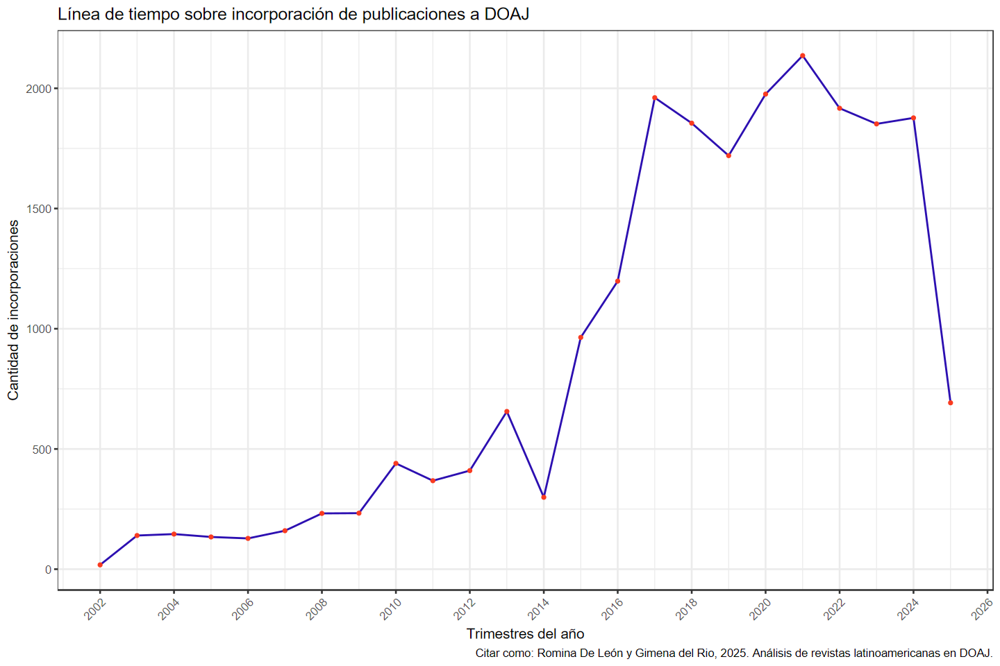

In [20]:
p2 <- journal.select %>%
  mutate( year_month = floor_date(Added, "year")) %>%
  count(year_month) %>%
  ggplot(aes(x = year_month, y = n)) +
  geom_line(color = "#2c0fb1", size = 0.6) +
  geom_point(color = "#f93b20", size = 1) +
  theme_bw(base_size = 12) +
  scale_x_date(date_labels = "%Y", date_breaks = "2 year") +
  labs(x = "Trimestres del año", y = "Cantidad de incorporaciones", 
       title = "Línea de tiempo sobre incorporación de publicaciones a DOAJ", caption = add_caption()) +
  theme(axis.text.x = element_text(angle = 45, hjust = 1),
       axis.text.y = element_text(hjust = 1)
       )
p2
save_graf(p2, type = "line")

#### Desagregado por países, según cantidad de publicaciones

Gráfico guardado en: Registro_de_incorporación_de_publicaciones_por_país_y_año



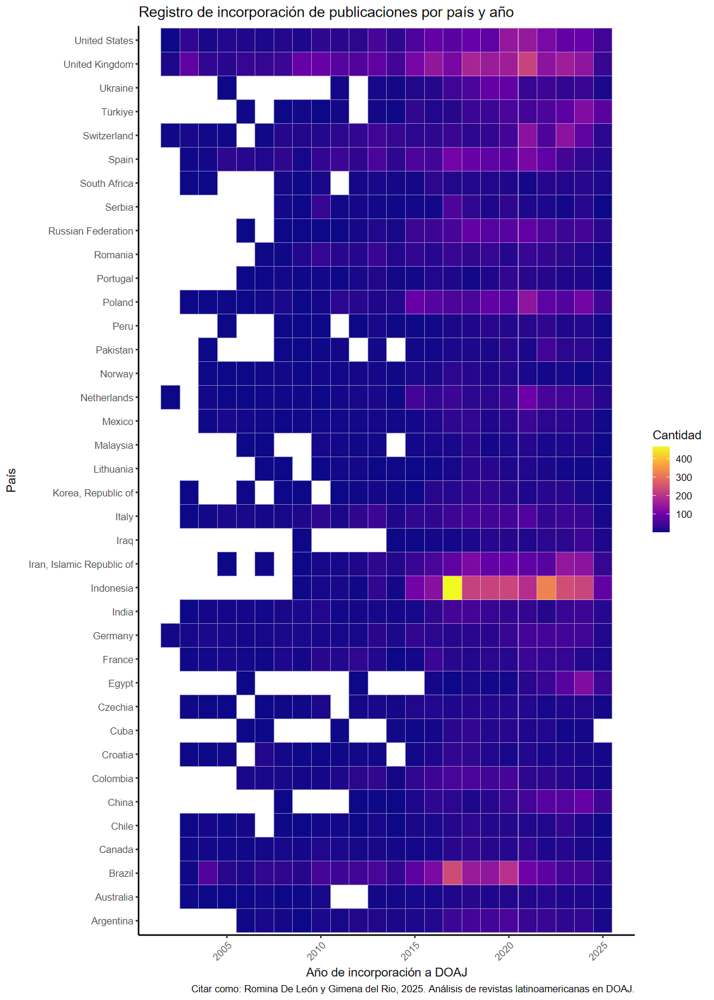

In [21]:
# tamaño específico para el heatmap ()
options(repr.plot.width = 10, repr.plot.height = 14)
p3 <- journal.select %>%
  mutate( year = floor_date(Added, "year")
  ) %>%
  count(country, year) %>% 
  group_by(country) %>%
  filter(sum(n) >= 100) %>%  
  ungroup() %>% 
  ggplot(aes(x = year, y = country, fill = n)) +
  geom_tile(color = "white") +
  scale_fill_viridis_c(option = "C") +
  labs(
    x = "Año de incorporación a DOAJ",
    y = "País",
    title = "Registro de incorporación de publicaciones por país y año",
    fill = "Cantidad",
    caption = add_caption()
  ) +
  theme_classic(base_size = 12) +
  theme(
    axis.text.x = element_text(angle = 45, hjust = 1),
    legend.position = "right" )

p3
save_graf(p3, type = "heatmap")

### Idiomas de publicación en todas las publicaciones de DOAJ
* Primero gráfico: Entre 30 y 800 publicaciones por país
* Segundo gráfico: Más de 800 publicaciones por país

In [22]:
options(repr.plot.width = 12, repr.plot.height = 8)

Warning message:
"textfont.color doesn't (yet) support data arrays"
Warning message:
"textfont.color doesn't (yet) support data arrays"
Warning message:
"textfont.color doesn't (yet) support data arrays"
Warning message:
"textfont.color doesn't (yet) support data arrays"


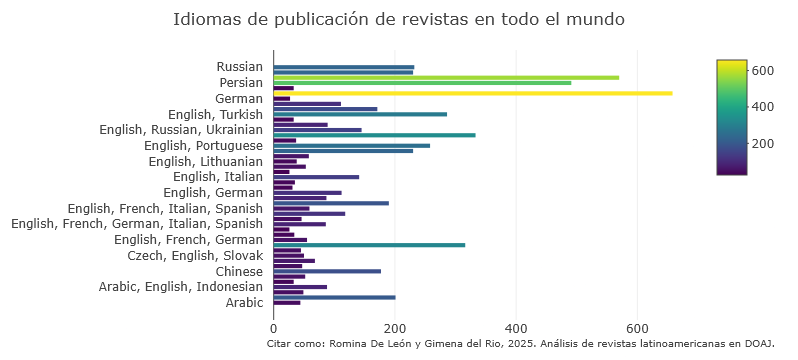

Warning message:
"textfont.color doesn't (yet) support data arrays"
Warning message:
"textfont.color doesn't (yet) support data arrays"


In [23]:
p4 <- journal.select %>%
  group_by(language) %>%
  count() %>%
  filter(n >= 25 & n <= 800 ) %>%
  mutate(language = as.character(fct_reorder(language, n))) %>%  
  plot_ly(
    x = ~n,
    y = ~language,
    type = "bar",
    orientation = "h",
    color = ~n,
    colors = viridisLite::viridis(100, option = "D")
  ) %>%
  layout(
    title = list(
      text = "Idiomas de publicación de revistas en todo el mundo",
      x = 0.5,  
      xanchor = "center"
    ),
    xaxis = list(title = "Cantidad de revistas"),
    yaxis = list(title = "Idiomas"),
    margin = list(l = 50, t = 50), 
    annotations = list(
      list(
        x = 0, y = -0.05, 
        text = add_caption(),  
        xref = "paper", yref = "paper",
        showarrow = FALSE,
        xanchor = "left",
        yanchor = "top",
        font = list(size = 10)
      )
    )
  )

p4

saveWidget(p4, file = "idiomas_pub_DOAJ_men800.html", selfcontained = FALSE)

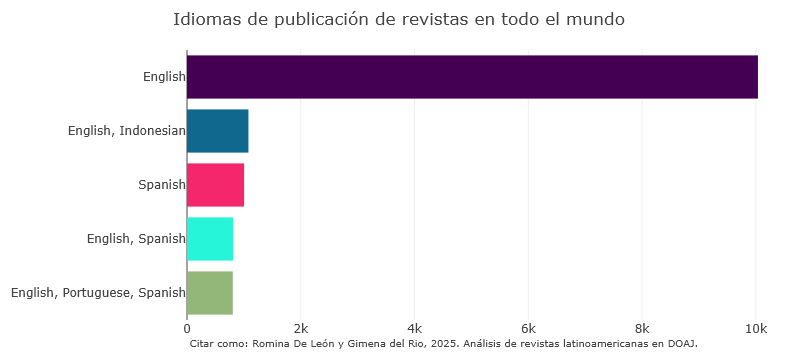

In [24]:
p5 <- journal.select %>%
  group_by(language) %>%
  count() %>%
  filter(n >= 800 ) %>%
  mutate(language = as.character(fct_reorder(language, n))) %>%  
  plot_ly(
    x = ~n,
    y = ~fct_reorder(language, n),
    type = "bar",
      orientation = "h",
      marker = list(color = c("#440154", "#11688e", "#92b779", "#27F5DA", "#F5276C"))) %>%
  layout(
    title = list(
      text = "Idiomas de publicación de revistas en todo el mundo",
      x = 0.5,  
      xanchor = "center"
    ),
    xaxis = list(title = "Cantidad de revistas"),
    yaxis = list(title = "Idiomas"),
    margin = list(l = 50, t = 50), 
    annotations = list(
      list(
        x = 0, y = -0.05, 
        text = add_caption(),  
        xref = "paper", yref = "paper",
        showarrow = FALSE,
        xanchor = "left",
        yanchor = "top",
        font = list(size = 10)
      )
    )
  )
p5

saveWidget(p5, file = "idiomas_pub_DOAJ_may800.html", selfcontained = FALSE)

### Gráfico considerando los idiomas de publicación según cada país

In [25]:
p6 <- journal.select %>%
  group_by(country, language) %>%
  count() %>%
  ungroup() %>%
  filter(n >= 150 & n <= 3000) %>%
  mutate(language = fct_reorder(language, n)) %>%
  plot_ly(x = ~country, y = ~language, z = ~n,
        type = "heatmap", colors = viridisLite::viridis(100, option = "C"), 
        hovertemplate = paste(
      "País: %{y}<br>",
      "Idioma: %{x}<br>",
      "Publicaciones: %{z}<extra></extra>")
    ) %>%
  layout(title = list(
      text = "Publicaciones con discriminación de idiomas según países",
      x = 0.5,  
      xanchor = "center"
    ),
    xaxis = list(tickangle = -45, tickfont = list(size = 8)),
    yaxis = list(tickangle = -25, tickfont = list(size = 8)),
    margin = list(l = 100, r = 20, t = 50, b = 50), 
    annotations = list(
      list(
        x = 0.35, y = -0.39, 
        xref = "paper", yref = "paper",
        showarrow = FALSE,
        xanchor = "left",
        yanchor = "top",
        font = list(size = 8),
        text = add_caption()
      )
    )
  )

p6
saveWidget(p6, file = "paises_idiomas_pub.html", selfcontained = FALSE)

HTML widgets cannot be represented in plain text (need html)

### Publicaciones en América Latina

#### América Latina
Selección de datos de países de Latinoamerica para realizar análisis sobre las publicaciones

In [26]:
# Filtrar los países de América Latina
selected_countries <- c("Brazil", "Argentina", "Mexico", "Colombia", "Ecuador", "Costa Rica", "Bolivia, Plurinational State of", "Dominican Republic", "El Salvador", "Guatemala", "	
Honduras", "Nicaragua", "Panama", "Chile", "Paraguay", "Peru", "Uruguay", "Venezuela, Bolivarian Republic of")
filtered_data <- porcen_journal %>% filter(country %in% selected_countries)
head(filtered_data)

country,n,percentage
<chr>,<int>,<dbl>
Argentina,390,1.81
"Bolivia, Plurinational State of",14,0.07
Brazil,1558,7.24
Chile,178,0.83
Colombia,440,2.05
Costa Rica,74,0.34


In [27]:

journal.amlat <- journal.select[journal.select$country %in% selected_countries, ]

print(paste("Total de publicaciones en América Latina:", length(journal.amlat$title)))

[1] "Total de publicaciones en América Latina: 3260"


In [28]:
head(journal.amlat)

title,country,language,license,Publisher,Review,Subjects,APC,Ids,Keywords,Added
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<date>
[re]Design,Brazil,"English, Portuguese, Spanish",CC BY-NC,Editora IFMA,Double anonymous peer review,Fine Arts,No,"ARK, DOI","design, architecture, arts",2023-06-01
Salud UIS,Colombia,"English, Portuguese, Spanish",CC BY,Publicaciones UIS,"Peer review, Double anonymous peer review",Medicine,No,,"health, medicine, salud, médicos, clinical",2016-10-26
CQD Revista Eletrônica Paulista de Matemática,Brazil,Portuguese,CC BY,UNESP,Double anonymous peer review,Science Mathematics,No,DOI,"mathematics, education, applied mathematics",2017-04-03
Derrotero,Colombia,Spanish,CC BY-NC-SA,Escuela Naval de Cadetes Almirante Padilla (ENAP),Double anonymous peer review,Naval Science,No,,"naval, naval science, military studies",2023-08-03
Journal of the Geological Survey of Brazil,Brazil,English,CC BY,Serviço Geológico do Brasil (CPRM),Anonymous peer review,Science Geology,No,DOI,"brazil, geology, geosciences, earth sciences",2019-03-25
Cadernos de Astronomia,Brazil,"English, Portuguese, Spanish",CC BY,Universidade Federal do Espírito Santo,"Editorial review, Anonymous peer review",Science Astronomy,No,DOI,"astronomy, cosmology, astronomy outreach, gravitation, history of science",2023-08-04


#### Gráfico interactiva sobre la cantidad de publicaciones en América Latina

In [29]:
#américa latina
p8 <- hchart(
  filtered_data,
  type = "pie",
  hcaes(x = country, y = percentage), 
  dataLabels = list(enabled = TRUE),  
  showInLegend = FALSE
) %>%
  hc_title(text = paste0(
    "<b>Porcentaje de las </b>",
    sum(filtered_data$n),
    "<b> publicaciones en América Latina</b>"
  )) %>%
  hc_subtitle(text = paste0("<i>Respecto a las ", length(journal.select$title) ," publicaciones de todo el mundo</i>")) %>%
  hc_exporting(
    enabled = TRUE, 
    filename = "paises_total"
  ) %>%
  hc_plotOptions(
    pie = list(
      allowPointSelect = TRUE,
      cursor = "pointer"
    )
  ) %>%
  hc_legend(
    enabled = FALSE, 
    layout = "horizontal",
    align = "center",
    verticalAlign = "bottom",
    y = 8
  )%>%
  hc_credits(
    enabled = TRUE,
  text = add_caption(),
  href = "https://github.com/rominicky/analisis-doaj",
  itemStyle = list(fontSize = "8px", fontWeight = "normal"),
  position = list(align = "left", x = 10, y = -5)
)
saveWidget(p8, file = "porcentaje_paises_amlat.html", 
           selfcontained = FALSE)
p8

HTML widgets cannot be represented in plain text (need html)

In [30]:
print(journal.amlat$Subjects)

                     Fine Arts                       Medicine 
                   "Fine Arts"                     "Medicine" 
           Science Mathematics                  Naval Science 
         "Science Mathematics"                "Naval Science" 
               Science Geology              Science Astronomy 
             "Science Geology"            "Science Astronomy" 
                  Language and          Technology Electrical 
                    "Language"        "Technology Electrical" 
               History General                  General Works 
             "History General"                "General Works" 
              Medicine Nursing              Medicine Internal 
            "Medicine Nursing"            "Medicine Internal" 
           Education Education                History General 
                   "Education"              "History General" 
         Philosophy Psychology        Agriculture Agriculture 
       "Philosophy Psychology"                  "Agricu

#### Vector para filtrar solo las Humanidades y Cs Sociales

In [31]:

social_sc <- c("Philosophy Psychology", "Geography Anthropology", "Education Theory", "Language and", "Political science", "History", "Education History", "Education Social", "History General", "History America", "Language", "Philosophy", "Bibliography Library", "Auxiliary sciences", "Education Special", "Education", "Social Sciences")

#### Línea de tiempo sobre la incorporación de publicaciones en América Latina

In [32]:
options(repr.plot.width = 12, repr.plot.height = 8)

Gráfico guardado en: Línea_de_tiempo_sobre_incorporación_de_publicaciones_de_América_Latina_a_DOAJ



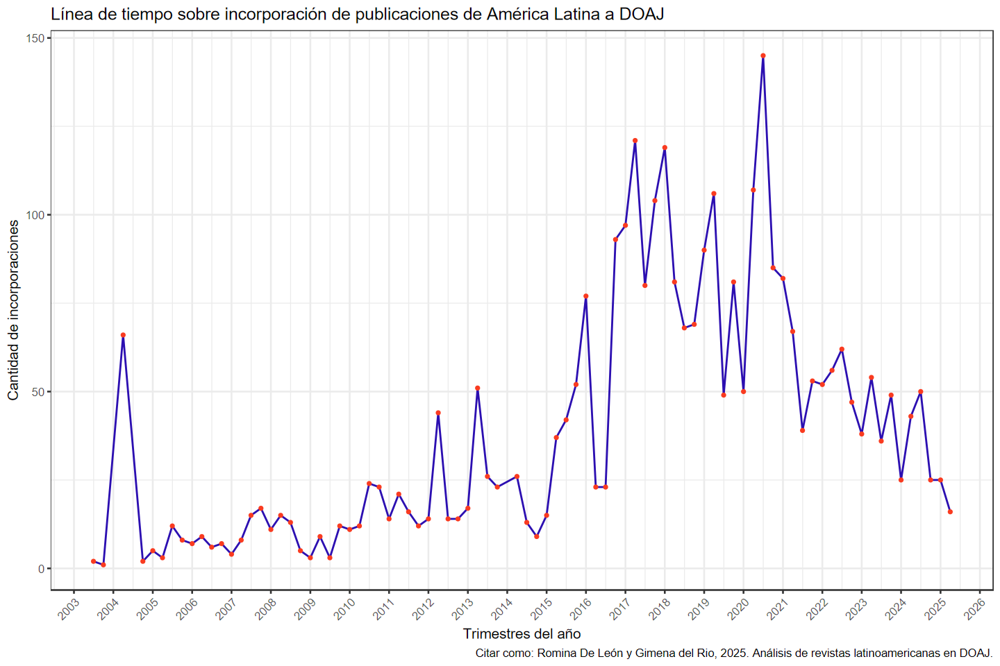

In [33]:
p9 <- journal.amlat %>%
  mutate( year_month = floor_date(Added, "quarter")) %>%
  count(year_month) %>%
  ggplot(aes(x = year_month, y = n)) +
  geom_line(color = "#2c0fb1", size = 0.6) +
  geom_point(color = "#f93b20", size = 1) +
  theme_bw(base_size = 12) +
  scale_x_date(date_labels = "%Y", date_breaks = "1 year") +
  labs(x = "Trimestres del año", y = "Cantidad de incorporaciones", 
       title = "Línea de tiempo sobre incorporación de publicaciones de América Latina a DOAJ", caption = add_caption()) +
  theme(axis.text.x = element_text(angle = 45, hjust = 1),
       axis.text.y = element_text(hjust = 1)
       )
p9
save_graf(p9, type = "line")

#### Publicaciones de Ciencias Sociales y Humanidades en América Latina

Gráfico guardado en: Revista_de_Social_Science_según_idiomas_de_publicación_de_América_Latina



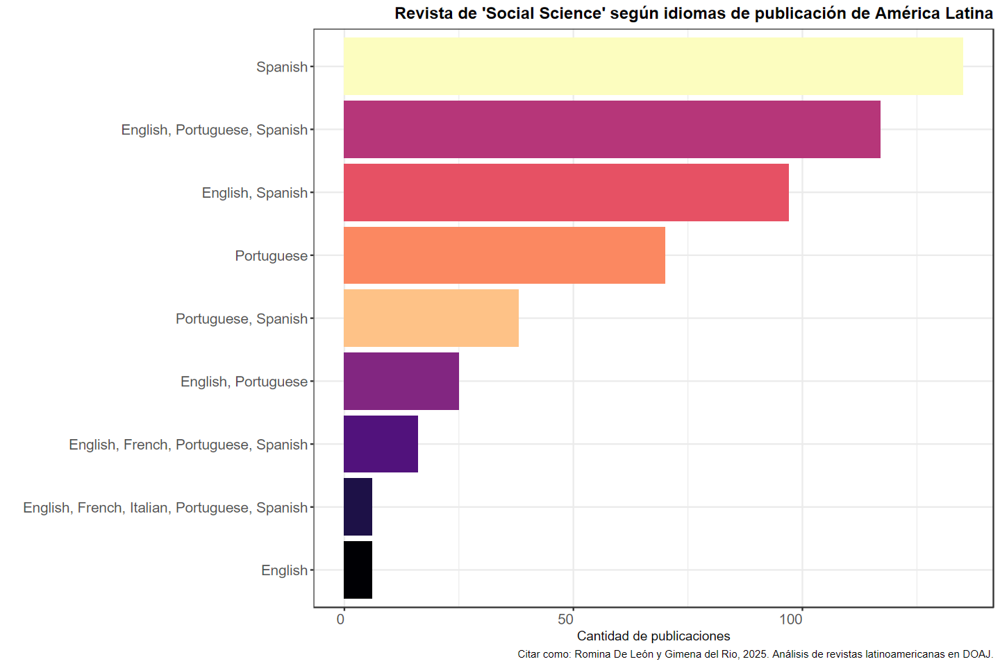

In [34]:
p10 <- journal.amlat %>%
  filter(Subjects == "Social Sciences") %>%  
  group_by(language) %>%
  count() %>%
  filter(n >= 5) %>%
  mutate(language = reorder(language, n)) %>%
  ggplot(aes(x = reorder(language, n), y = n, fill = language)) +
  geom_col() +
  theme_bw() +
  theme(legend.position = "none") + 
  scale_fill_viridis_d(option = "A") +
  labs(y = "Cantidad de publicaciones", x = "",
       title = "Revista de 'Social Science' según idiomas de publicación de América Latina",
       caption = add_caption()) +
       theme(plot.title = element_text(hjust = 1, size = 14, face = "bold"),
       axis.text.x = element_text(hjust = 1, size = 12),
       axis.text.y = element_text(hjust = 1, size = 12)
       ) + coord_flip()
p10
save_graf(p10, type = "bar")

Gráfico guardado en: Revista_de_Cs_Sociales_y_Humanidades_según_idiomas_de_publicación_de_América_Latina



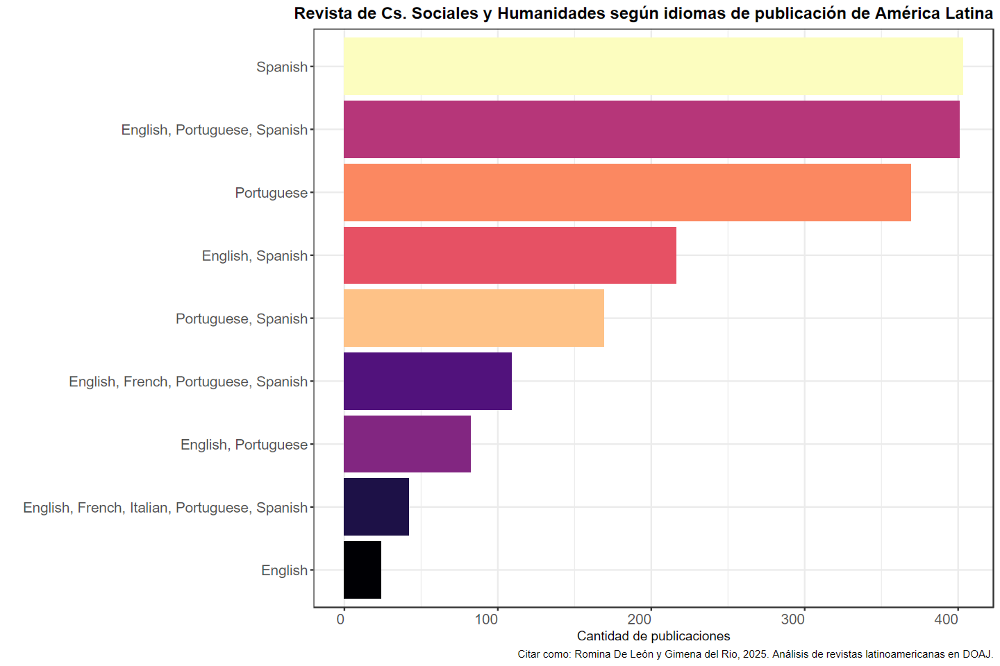

In [35]:

p11 <- journal.amlat %>%
  filter(Subjects %in% social_sc) %>%
  group_by(language) %>%
  count() %>%
  filter(n >= 10) %>%
  mutate(language = reorder(language, n)) %>%
  ggplot(aes(x = reorder(language, n), y = n, fill = language)) +
  geom_col() +
  theme_bw() +
  theme(legend.position = "none") + 
  scale_fill_viridis_d(option = "A") +
  labs(y = "Cantidad de publicaciones", x= "", 
       title = "Revista de Cs. Sociales y Humanidades según idiomas de publicación de América Latina",
       caption = add_caption()) +
       theme(plot.title = element_text(hjust = 1, size = 14, face = "bold"),
       axis.text.x = element_text(hjust = 1, size = 12),
       axis.text.y = element_text(hjust = 1, size = 12)
       ) + coord_flip()

p11
save_graf(p11, type = "bar")

#### Publicaciones según países y desagregadas por idiomas 

In [36]:
p12 <- journal.amlat %>%
  group_by(country, language) %>%
  count() %>%
  ungroup() %>%
  filter(n >= 5 & n <= 410) %>%
  mutate(language = fct_reorder(language, n)) %>%
  plot_ly(x = ~country, y = ~language, z = ~n,
        type = "heatmap", colors = viridisLite::viridis(100, option = "C"), 
        hovertemplate = paste(
      "País: %{y}<br>",
      "Idioma: %{x}<br>",
      "Publicaciones: %{z}<extra></extra>")
    ) %>%
  layout(title = list(
      text = "Distribución según idiomas de publicaciones académicas de América Latina",
      x = 0.5,  
      xanchor = "center"
    ),
    xaxis = list(tickangle = -45, tickfont = list(size = 8)),
    yaxis = list(tickangle = -25, tickfont = list(size = 8)),
    margin = list(l = 100, r = 20, t = 50, b = 50), 
    annotations = list(
      list(
        x = 0.35, y = -0.58, 
        xref = "paper", yref = "paper",
        showarrow = FALSE,
        xanchor = "left",
        yanchor = "top",
        font = list(size = 8),
        text = add_caption()
      )
    )
  )

p12
saveWidget(p12, file = "amlat_idiomas_pub.html", selfcontained = FALSE)

HTML widgets cannot be represented in plain text (need html)

#### Gráfico de dispersión con etiquetas de conteo

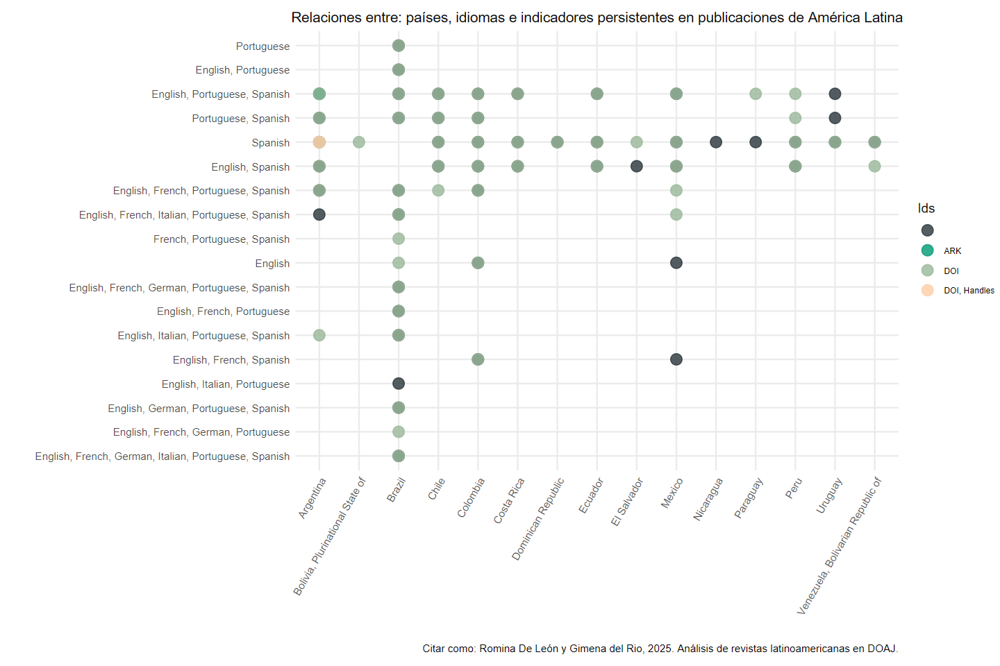

In [78]:

p13 <- journal.amlat %>%
         filter(Subjects %in% social_sc) %>% 
         group_by(language, country, Ids) %>% 
         summarise(count = n(), .groups = "drop") %>%
          filter(count >= 2) %>%
          mutate(language = reorder(language, count)) %>%
          ggplot(aes(x = country, y = language, color = Ids)) +
          geom_point(size = 4, alpha = 0.8) +
          theme_minimal() +
          theme(
        plot.title = element_text(hjust = 0.5, size = 12),
        axis.text.x = element_text(angle = 60, hjust = 1),
        legend.position = "right",
        legend.box = "horizontal",
        legend.title = element_text(size = 11),
        legend.text = element_text(size = 7),
        legend.spacing.y = unit(-0.1, "cm"),
        plot.margin = margin(t = 10, r = 0, b = 10, l = 10)
      ) +
      guides(color = guide_legend(ncol = 1, byrow = TRUE)) +
      scale_color_paletteer_d("awtools::a_palette") +
      labs(
        x = "",
        y = "",
        caption = add_caption(),
        title = "Relaciones entre: países, idiomas e indicadores persistentes en publicaciones de América Latina")

p13


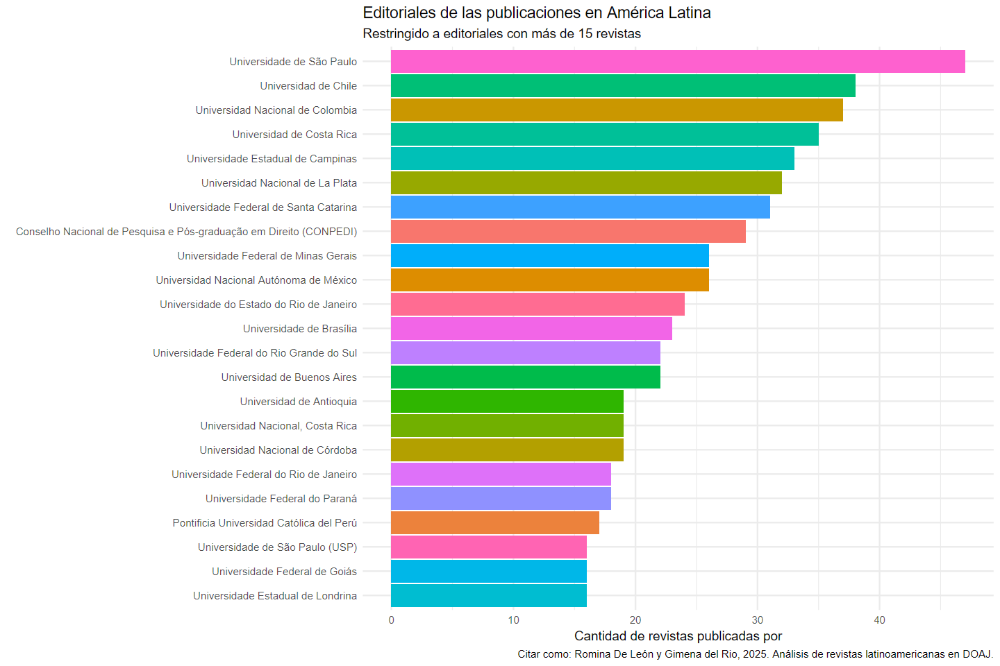

In [38]:
#otro gráfico
journal.amlat %>%
  group_by(Publisher)%>%
  count()%>%
  filter(n>15)%>%
  mutate(Publisher = reorder(Publisher, n)) %>%
  ggplot(aes(x = reorder(Publisher, n), y = n, fill = Publisher)) +  # Ordenar x según la frecuencia -n
  geom_col () + # si agrego , fill = "blue" cambio color
  theme_minimal() +
  theme(legend.position = "n") +
  scale_color_scico_d(palette = "berlin") +
  ylab("Cantidad de revistas publicadas por") +
  xlab(NULL) +
  ggtitle("Editoriales de las publicaciones en América Latina",
    subtitle = "Restringido a editoriales con más de 15 revistas") +
  coord_flip() +
  labs(caption = add_caption())


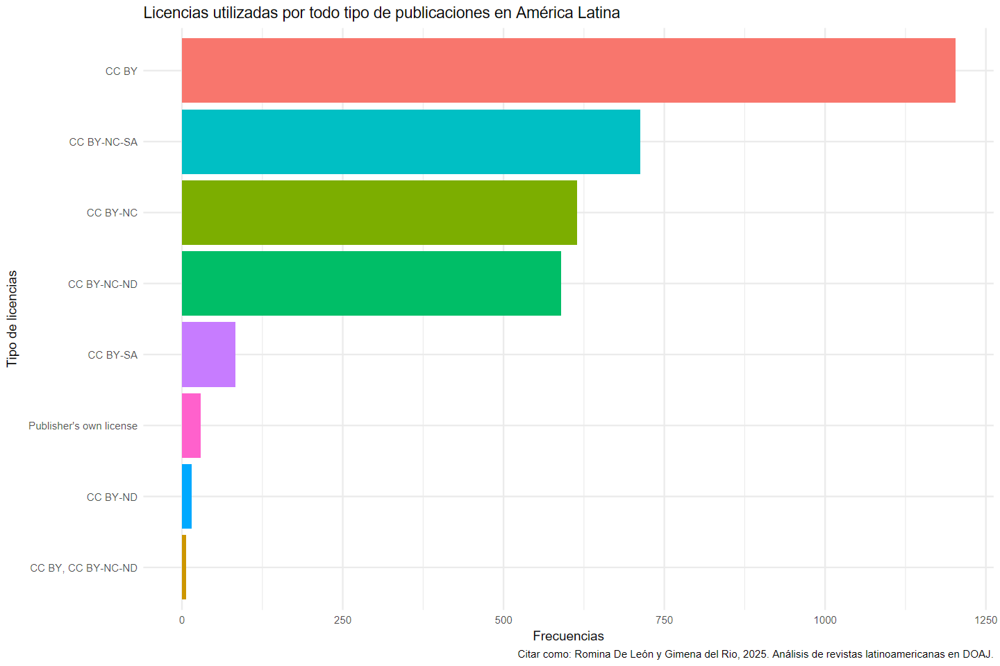

In [39]:

journal.amlat %>%
  group_by(license) %>%
  count() %>%
  filter(n >= 5) %>%
  mutate(license = reorder(license, n)) %>%
  ggplot(aes(x = reorder(license, n), y = n, fill = license)) +
  geom_col() +
  scale_color_scico_d(palette = "berlin") +
  theme_minimal() +
  theme(legend.position = "n") +  # debe ser "none", no "n"
  ylab("Frecuencias") +
  xlab("Tipo de licencias") +
  ggtitle("Licencias utilizadas por todo tipo de publicaciones en América Latina") +
  coord_flip() +
  labs(caption = add_caption())


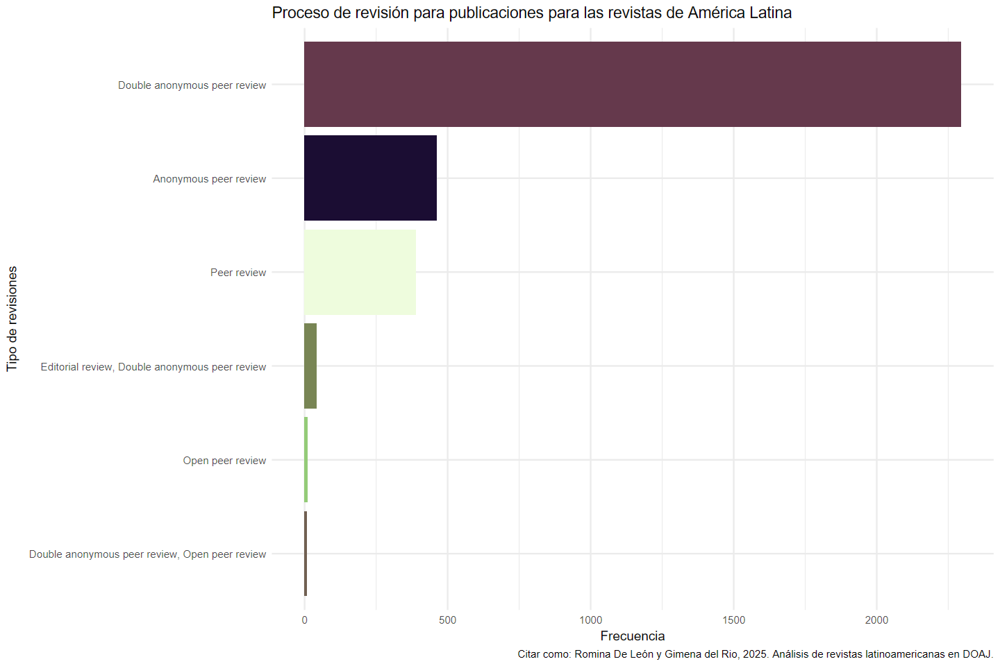

In [40]:

journal.amlat %>%
  group_by(Review)%>%
  count()%>%
  filter(n>=8)%>%
  mutate(Review = fct_reorder(Review, n)) %>%
  ggplot(aes(x = reorder(Review, n), y = n, fill = Review)) +
  geom_col () + # si agrego , fill = "blue" cambio color
  scale_fill_scico_d(palette = "tokyo") +
  theme_minimal() +
  theme(legend.position = "n") +
  ylab("Frecuencia") +
  xlab("Tipo de revisiones") +
  ggtitle("Proceso de revisión para publicaciones para las revistas de América Latina") +
  #scale_color_scico_d(palette = "lajolla") +
  coord_flip() +
  labs(caption = add_caption())

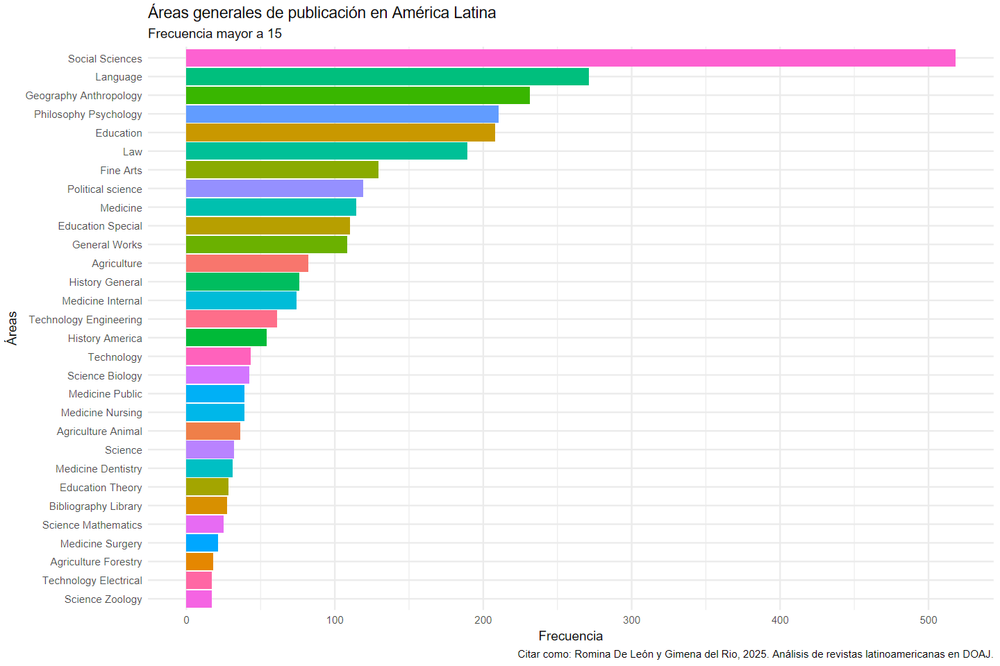

In [41]:

journal.amlat %>%
  group_by(Subjects) %>%
  count() %>%
  filter(n > 15) %>%
  mutate(Subjects = fct_reorder(Subjects, n)) %>%
  ggplot(aes(x = reorder(Subjects, n), y = n, fill = Subjects)) +
  geom_col() +
  theme_minimal() +
  theme(legend.position = "n") +
  ylab("Frecuencia") +
  xlab("Áreas") +
  ggtitle("Áreas generales de publicación en América Latina",
          subtitle = "Frecuencia mayor a 15") +
  scale_color_scico_d(palette = "berlin") +
  coord_flip() +
  labs(caption = add_caption())